# ATO dataset for panfetal paper
# 11 Nov 2021 Chenqu

In [1]:
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import rc
from matplotlib import colors
import seaborn as sb
from itertools import compress
import random
import joblib as jl
import matplotlib.patches as mpatches

sc.settings.set_figure_params(dpi = 160, color_map = 'RdYlBu_r', dpi_save = 300, format = 'pdf')
plt.rcParams["figure.figsize"] = [6,6]
#plt.rcParams['font.sans-serif']=['Arial']
#rc('font', **{'family':'sans-serif', 'sans-serif':['Arial']})
#plt.rcParams['pdf.fonttype'] = 'truetype'

In [2]:
sb.set_palette('tab10')

In [3]:
# import utils
import sys
sys.path.append('/home/jovyan/chenqu_utils')
from array_operations import *
sys.path.append('/home/jovyan/thymusatlas/')
import scjp
from scjp import model

In [4]:
organ_order = ['YS','LI','BM','TH','SP','MLN','SK','GU','KI']

In [5]:
# set working directory
%cd /home/jovyan/panfetal/

/home/jovyan/panfetal


In [6]:
# figure directory
fig_path = '/home/jovyan/mount/gdrive/Pan_fetal/plots_output/chenqu_jhub/'
sc.settings.figdir = fig_path

# Load scVI object

In [7]:
adata_raw = sc.read('/nfs/team205/ed6/data/Fetal_immune/ATO_query.scVI.h5ad')

In [8]:
adata=adata_raw.copy()
adata.var.index = adata.var['gene_names']
sc.pp.normalize_per_cell(adata,counts_per_cell_after=10e4,key_n_counts='total_counts')
sc.pp.log1p(adata)

In [9]:
adata.raw = adata.copy()

In [10]:
mito_genes = adata.var_names.str.startswith('MT-')
adata.obs['mito_recalculate'] = (np.sum(adata.X[:, mito_genes],axis=1).A1) / (np.sum(adata.X,axis=1).A1)

In [11]:
meta = pd.read_csv('metadata/ATO_metadata_26102021.csv')

In [12]:
adata.obs['sample'] = [name.split('_')[1] for name in adata.obs_names]
adata.obs['ATO_wk']= list(meta.loc[lookup(adata.obs['sample'],meta['sequence_name']),'ATO_wk'])

In [13]:
adata.obs['ATO_wk'] = adata.obs['ATO_wk'].astype('category')

# Annotation by leiden cluster

... storing 'sample' as categorical


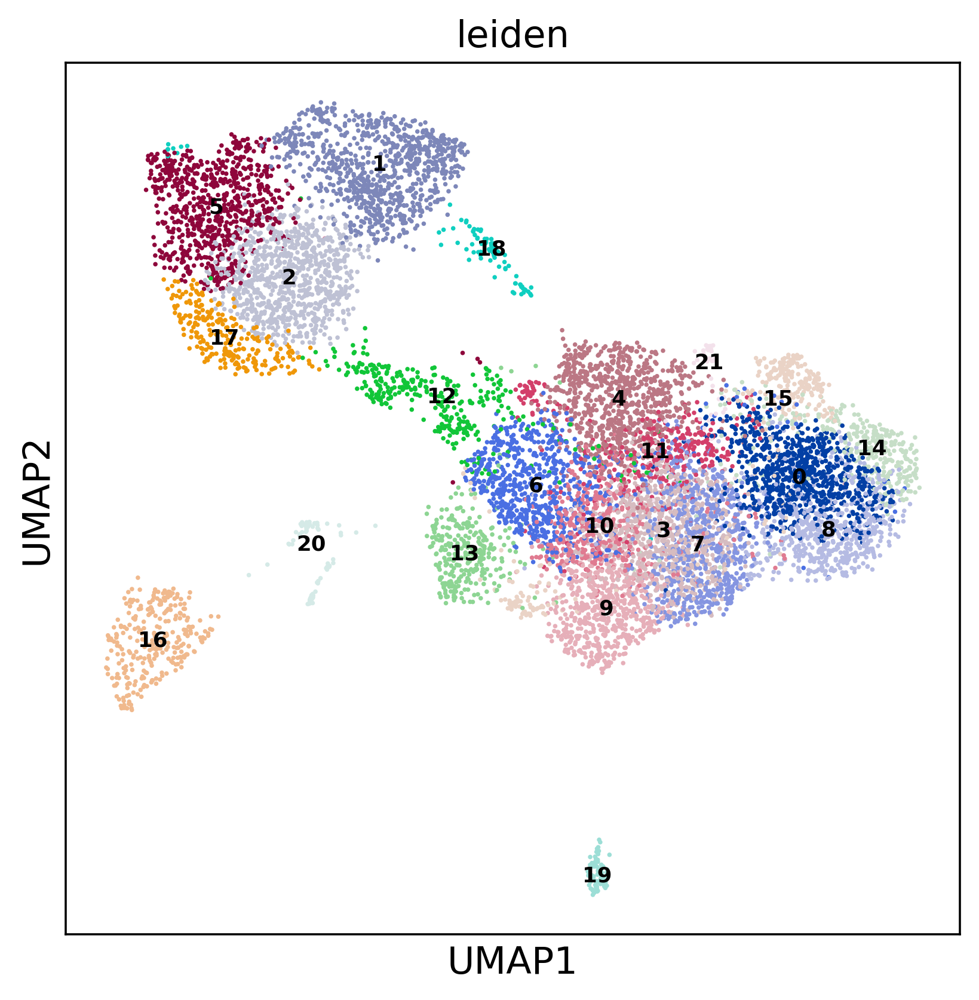

In [14]:
sc.pl.umap(adata,color='leiden', legend_loc = 'on data',legend_fontsize =8)

### Annotation prediction with panfetal dataset

In [15]:
import celltypist
from celltypist import models

In [16]:
celltypist.__version__

'0.1.5'

In [17]:
adata_new=adata_raw.copy()
#adata_new.var.index = adata_new.var['gene_names']
sc.pp.normalize_per_cell(adata_new,counts_per_cell_after=1e4,key_n_counts='total_counts')
sc.pp.log1p(adata_new)

In [18]:
adata_new.var_names  = adata_new.var['gene_names']
adata_new.var_names_make_unique()
adata_new.raw = adata_new.copy()

In [38]:
predictions = celltypist.annotate(adata_new, model = '/lustre/scratch117/cellgen/team205/cx1/Celltypist/pan_fetal/models/Pan_Fetal_Human.pkl', majority_voting = True)

🔬 Input data has 10459 cells and 33538 genes
🔗 Matching reference genes in the model
🧬 6971 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


In [39]:
adata_new = predictions.to_adata()

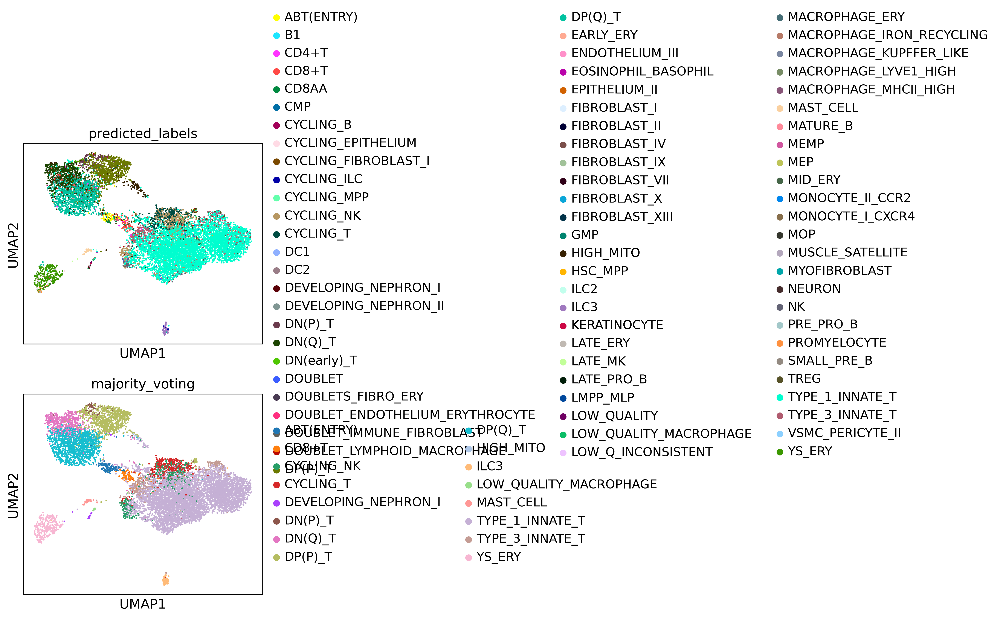

In [40]:
sc.pl.umap(adata_new, color=['predicted_labels','majority_voting'],ncols=1)

In [41]:
for col in ['predicted_labels','majority_voting']:
    adata.obs[col]=adata_new.obs[col]

In [42]:
adata.obsm['proba'] = predictions.probability_matrix

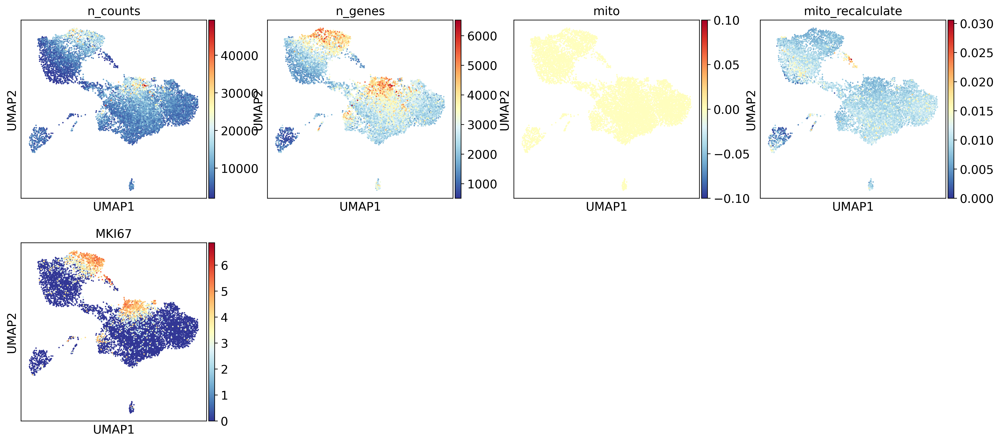

In [43]:
sc.pl.umap(adata,color=['n_counts','n_genes','mito','mito_recalculate','MKI67'])

### marker gene plot

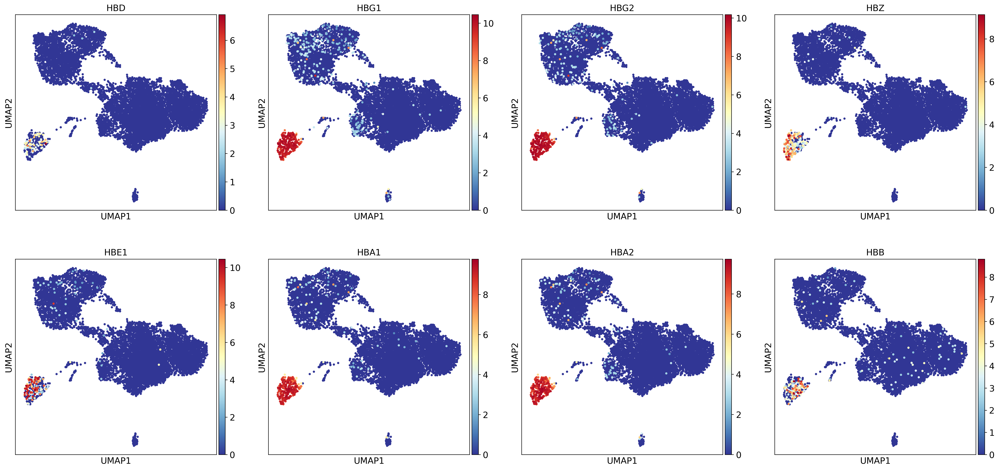

In [33]:
genes = ['HBD','HBG1','HBG2','HBZ','HBE1','HBA1','HBA2','HBB']
sc.pl.umap(adata, color = genes,size=50) # mainly express HBG1, HBG2, HBA1

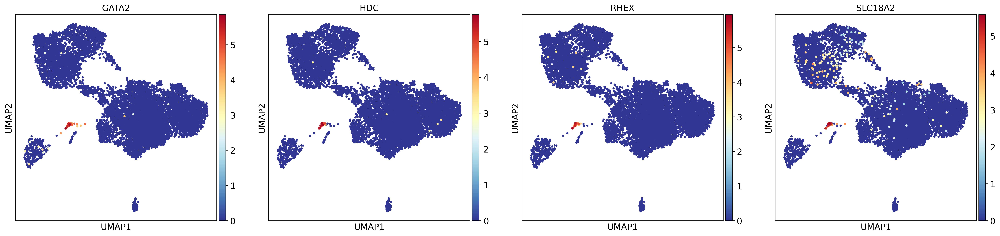

In [45]:
genes = ['GATA2','HDC','RHEX','SLC18A2'] # EO/BASO/MAST
sc.pl.umap(adata, color = genes,size=50)

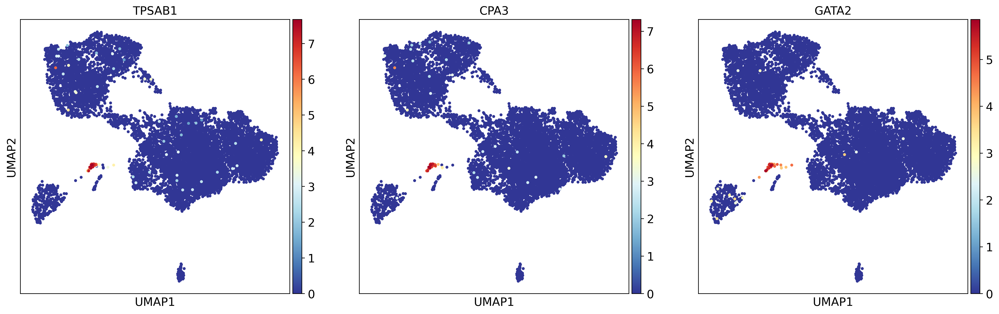

In [35]:
genes = ['TPSAB1','CPA3','GATA2'] # mast cell markers
sc.pl.umap(adata, color = genes,size=50)

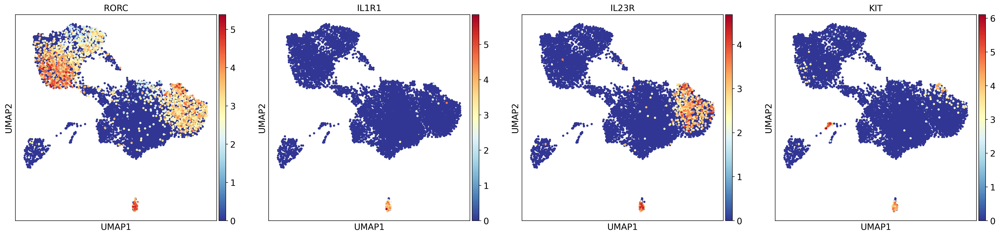

In [46]:
genes = ['RORC','IL1R1','IL23R','KIT'] # ILC3
sc.pl.umap(adata, color = genes,size=50)

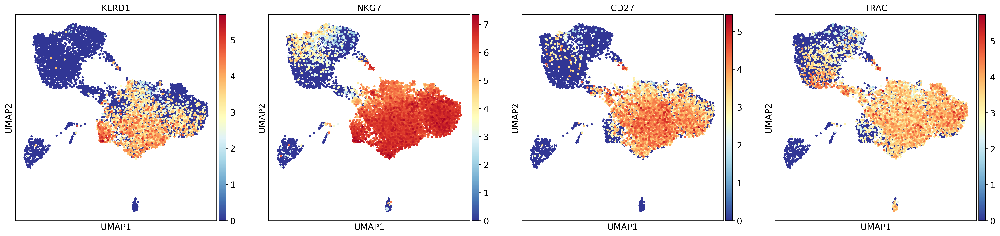

In [49]:
genes = ['KLRD1','NKG7','CD27','TRAC'] # NK cells, positive for NK markers and absent for CD27 and TRAC
sc.pl.umap(adata, color = genes,size=50)

In [51]:
genes = ['IGLL1','ST18','TRGC2','TRDC','HIVEP3','RAG1','RAG2','TP53INP1','PTCRA','RGPD3',
         'SMPD3','AQP3','RORC','CCR9','SATB1','TOX2','CCR7','CD5','CD27','CD8A','CD8B','CD4','MKI67']
sc.pl.umap(adata, color = genes,size=50)

### load annotation by leiden

In [25]:
annot = pd.read_csv('annot/ATO_scVI_anno.csv',sep=',', index_col=None)

In [26]:
adata.obs['anno_lvl_1']= np.nan
for i in range(annot.shape[0]):
    leiden = annot.iloc[i,0].astype('str')
    annot_lvl1 = annot.iloc[i,1]
    adata.obs.loc[adata.obs['leiden']==leiden,'anno_lvl_1'] = annot_lvl1

In [27]:
adata.obs['anno_lvl_1'] =adata.obs['anno_lvl_1'].astype('category')
adata.obs['anno_lvl_1'] =adata.obs['anno_lvl_1'].cat.reorder_categories(['DN/DP', 'ABT(ENTRY)', 'SP_T',
                                                                         'NK','ILC3', 'ERY', 'MAST CELL', 'HIGH_MITO'])

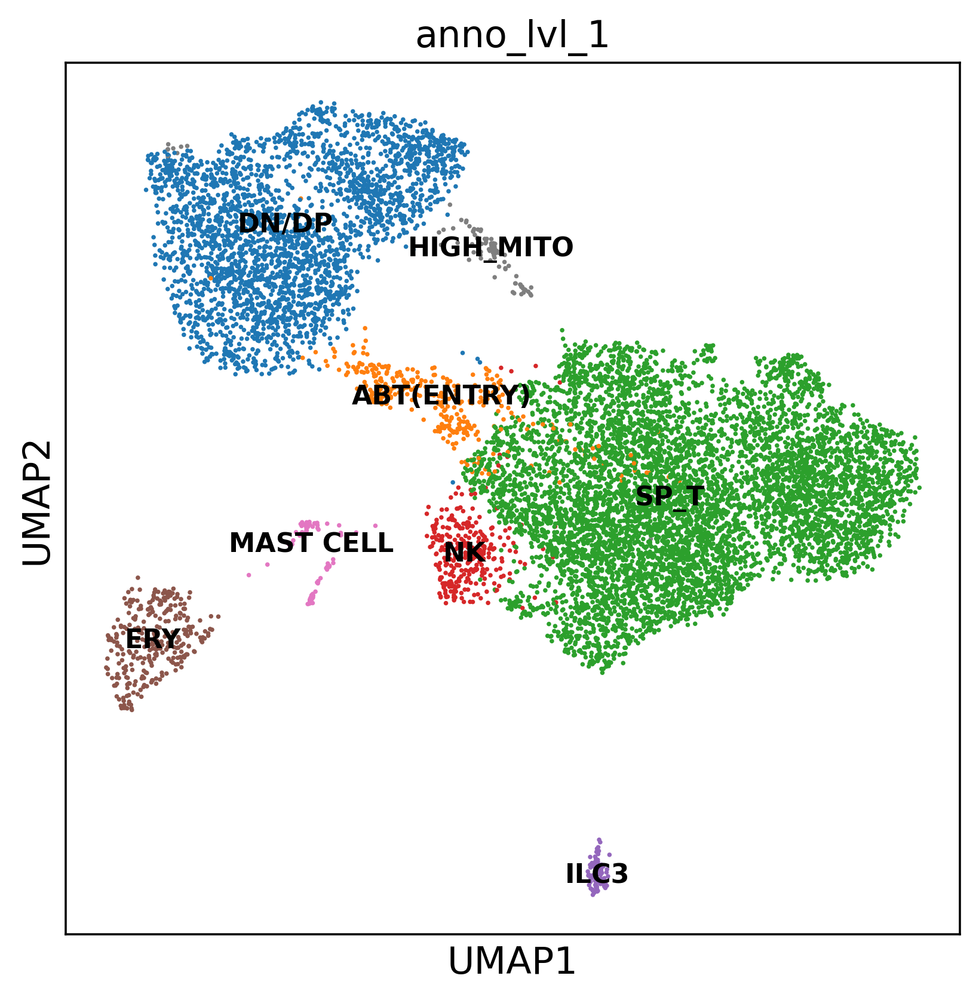

In [28]:
plt.rcParams["figure.figsize"] = [6,6]
sc.pl.umap(adata,color=['anno_lvl_1'], ncols=1, legend_loc = 'on data', legend_fontsize=10,save='ATO_umap.pdf')
#plt.savefig(fig_path+'ATO_umap.svg',bbox_inches='tight')

### Plot umap by cell line

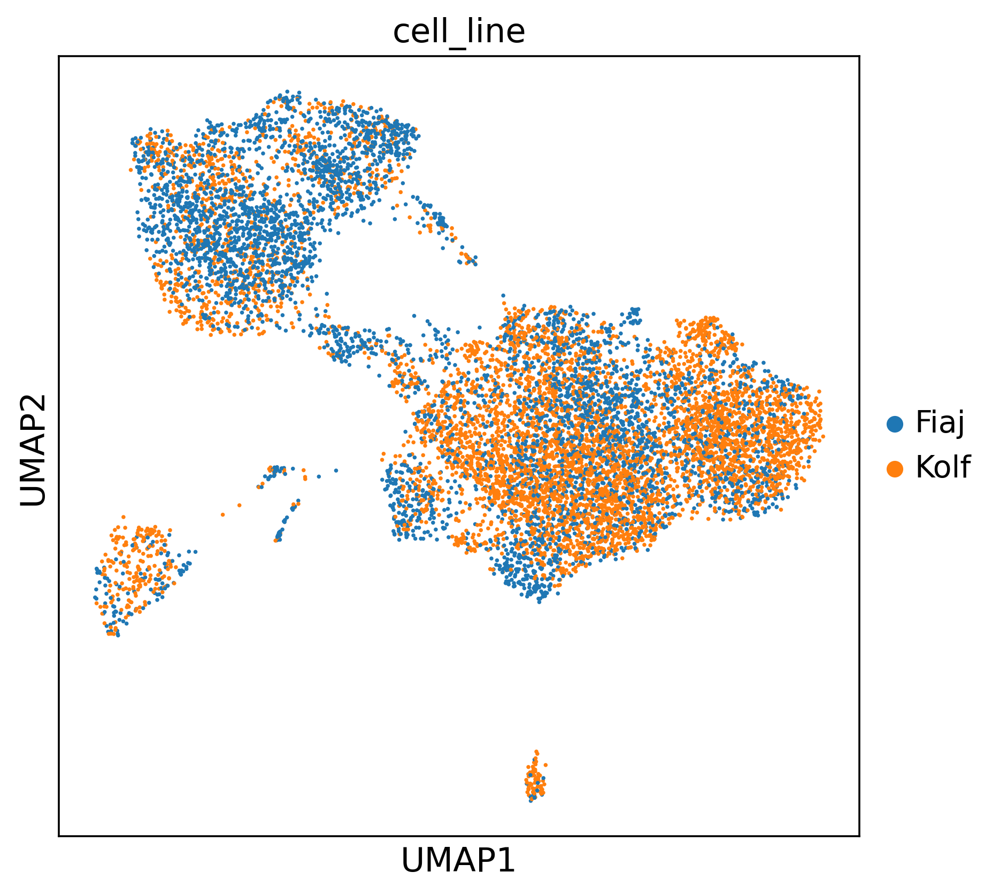

In [29]:
plt.rcParams["figure.figsize"] = [6,6]
sc.pl.umap(adata,color=['cell_line'], ncols=1, legend_loc = 'right margin', save='ATO_umap_cell_line.pdf')

### plot dotplot

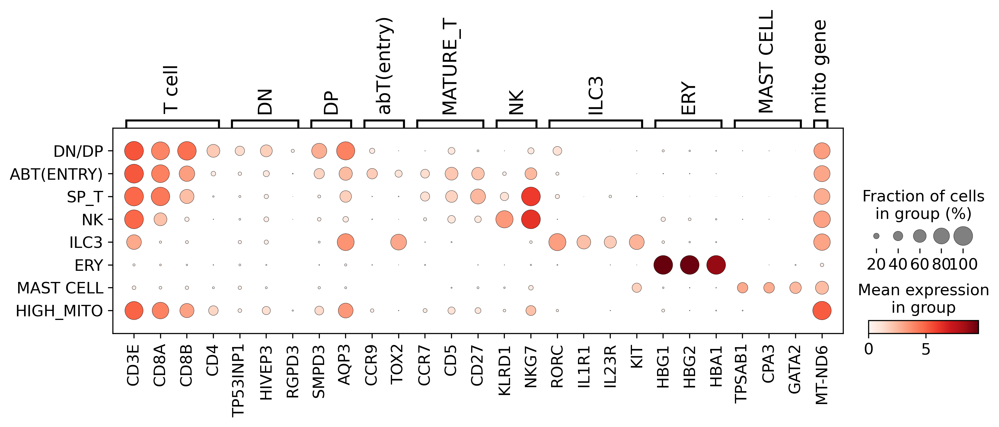

In [30]:
markers = {'T cell':['CD3E','CD8A','CD8B','CD4'],
           'DN':['TP53INP1','HIVEP3','RGPD3'],
           'DP':['SMPD3','AQP3'], 
           'abT(entry)':['CCR9','TOX2'], 
           'MATURE_T':['CCR7','CD5','CD27'], 
           'NK': ['KLRD1','NKG7'],
           'ILC3': ['RORC','IL1R1','IL23R','KIT'],
           'ERY':['HBG1', 'HBG2', 'HBA1'],
           'MAST CELL':['TPSAB1','CPA3','GATA2'],
           'mito gene':['MT-ND6']
          }
sc.pl.dotplot(adata, markers, 'anno_lvl_1', dendrogram=False, use_raw=False, save='ATO_dotplot.pdf')

In [31]:
adata.obs['anno_lvl_1'].to_csv('csv/ATO_anno_lvl_1.csv')

### Plot marker genes to show T cell development in ATO

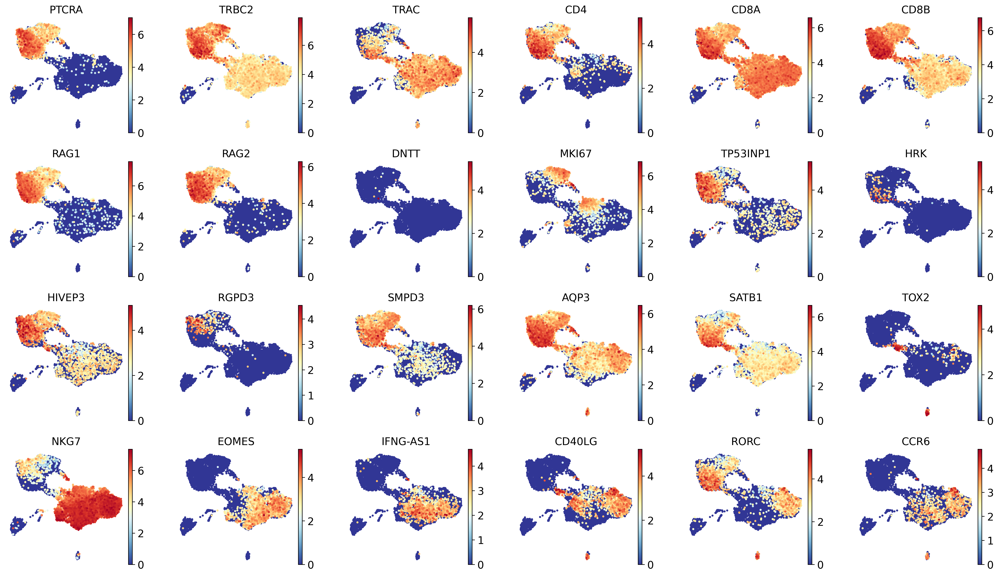

In [36]:
plt.rcParams["figure.figsize"] = [3,3]
genes = ['PTCRA','TRBC2','TRAC', #TCR 
'CD4','CD8A','CD8B', #CD4/8
'RAG1','RAG2','DNTT', #recombination
'MKI67','TP53INP1','HRK', #proliferation & apoptosis
'HIVEP3','RGPD3',#stage markers for DN
         'SMPD3','AQP3',#stage markers for DP
         'SATB1','TOX2',#stage markers for ABTENTRY
        'NKG7','EOMES','IFNG-AS1', # NKT
'CD40LG','RORC','CCR6'] # TH17
sc.pl.umap(adata,color=genes, ncols=6,size=30,frameon=False,save='ATO_markers.pdf')

### density plot across ATO weeks

In [33]:
sc.tl.embedding_density(adata, basis='umap', groupby='ATO_wk')

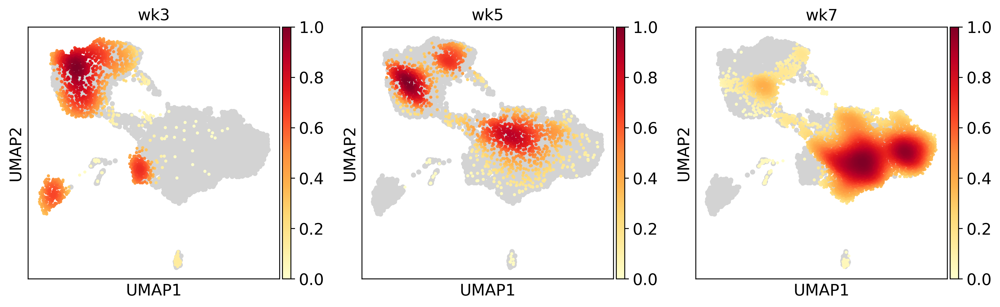

In [34]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.embedding_density(adata,basis='umap', key='umap_density_ATO_wk',fg_dotsize =30,save='ato_wk.pdf')

# Show SPs are close to unconventional T cells

### use logistic regression (from celltypist) results to show 

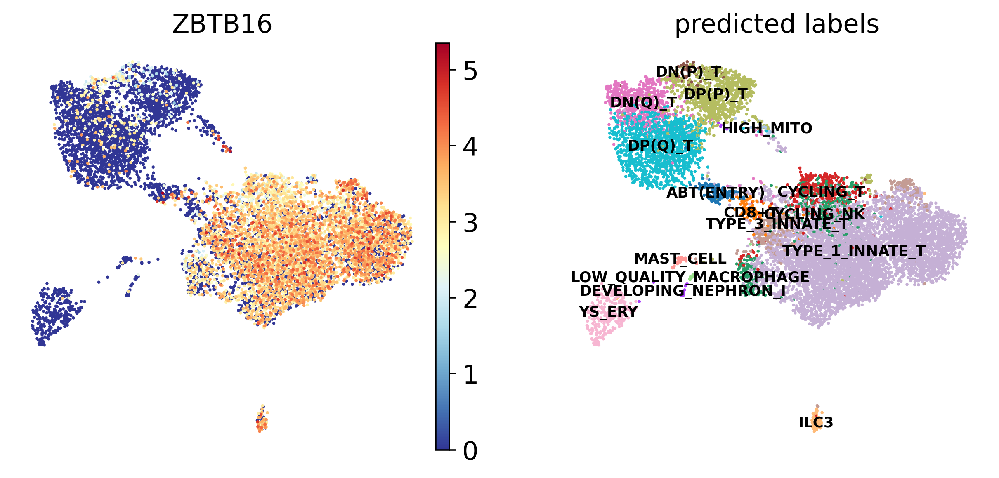

In [44]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.umap(adata,color=['ZBTB16','majority_voting'],title = ['ZBTB16','predicted labels'],legend_loc='on data',legend_fontsize=8,frameon=False,save='ATO_LR_PLZF.pdf')

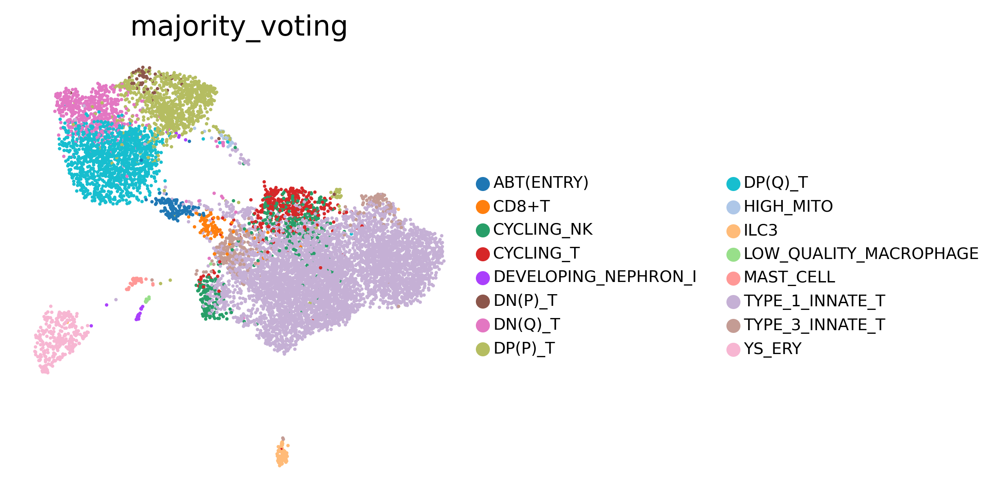

In [45]:
sc.pl.umap(adata,color=['majority_voting'],legend_loc='right margin',legend_fontsize=8,frameon=False)

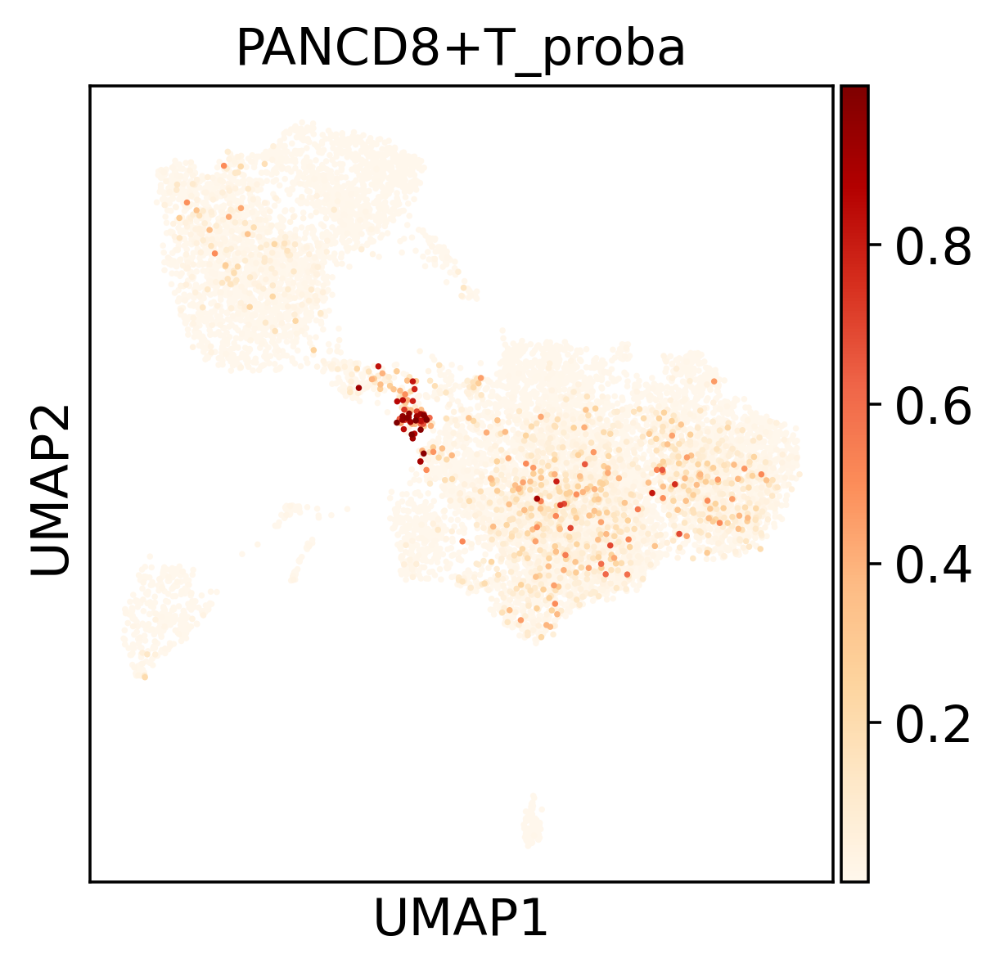

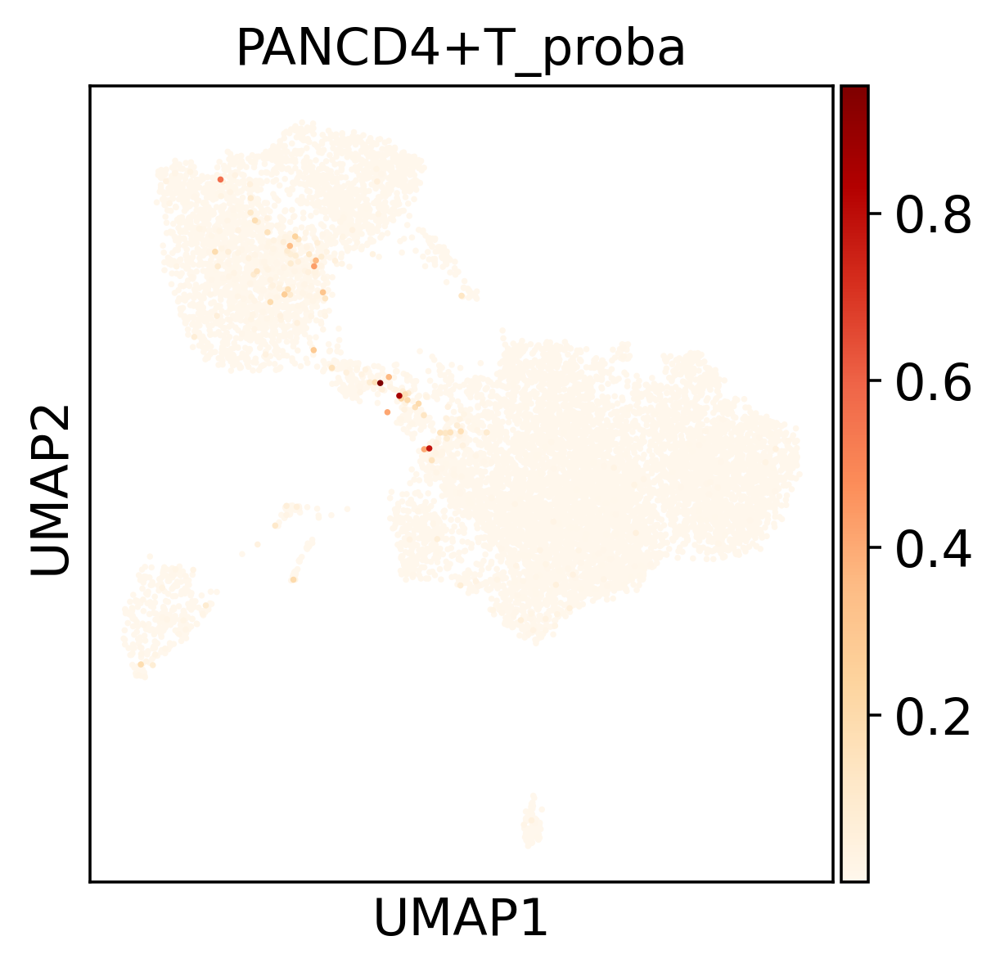

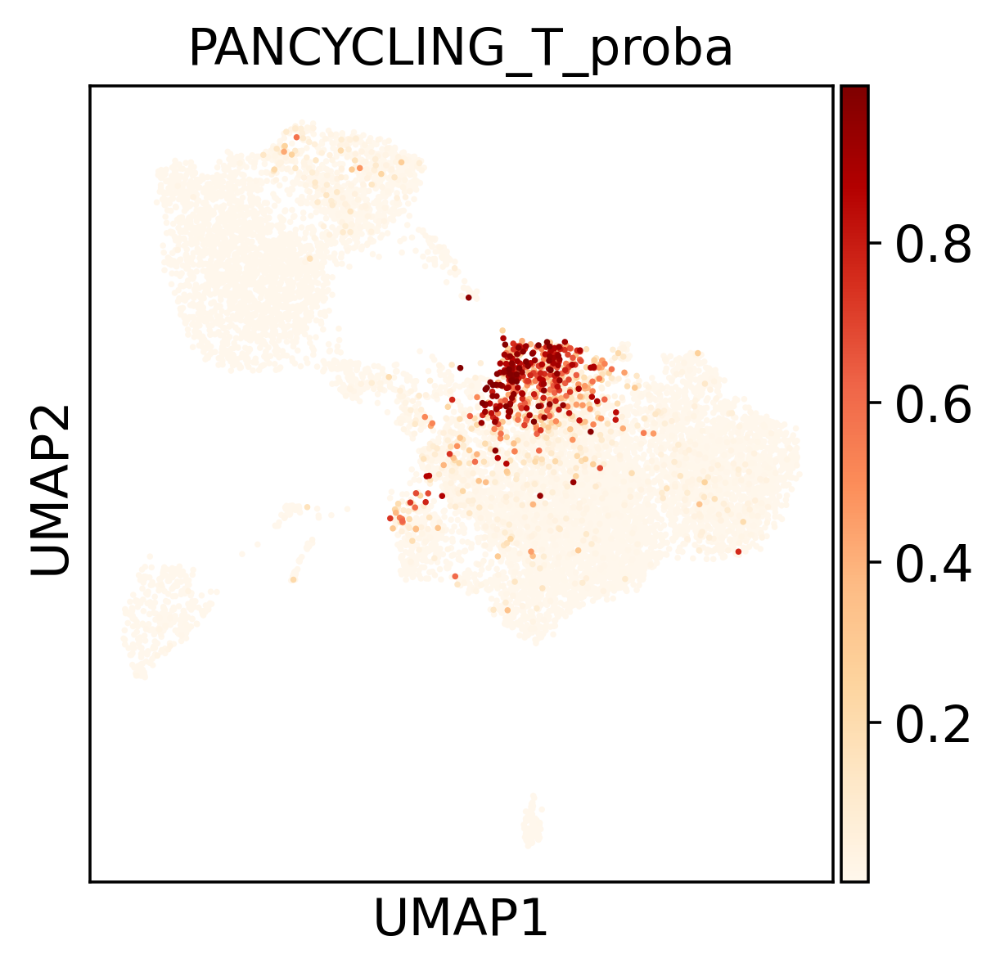

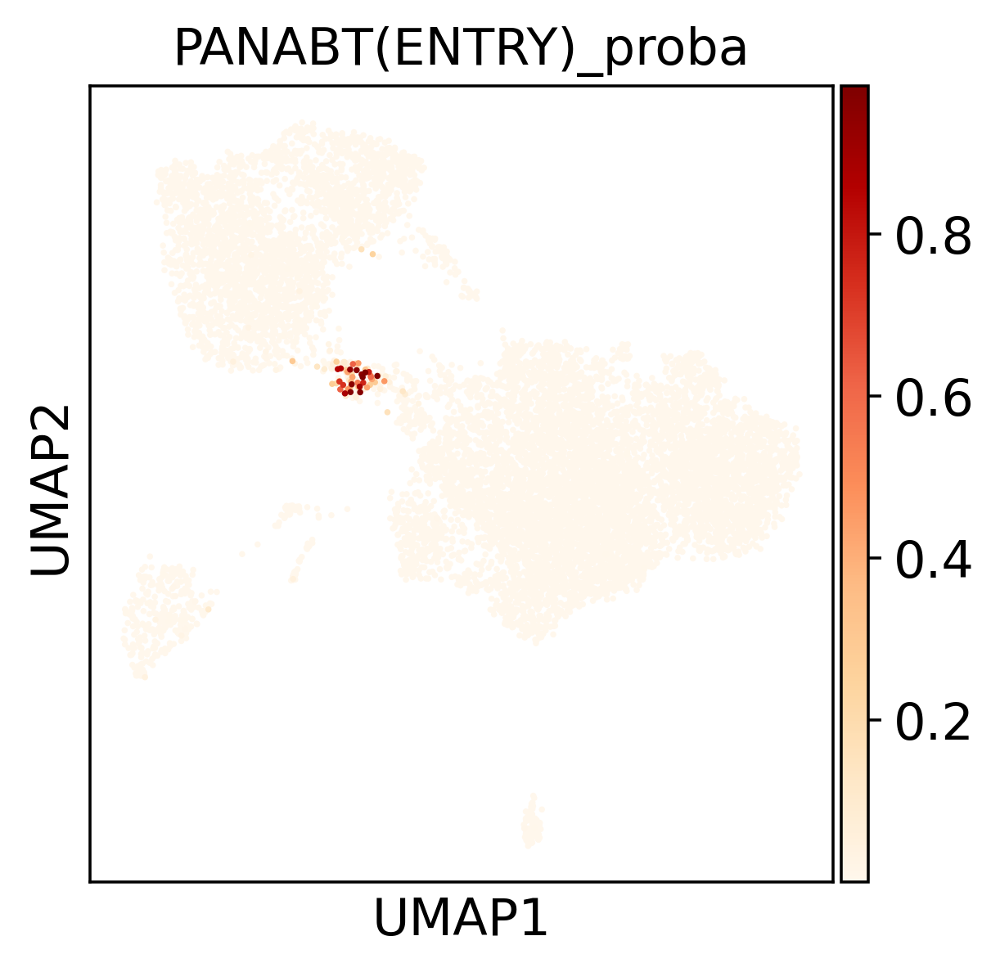

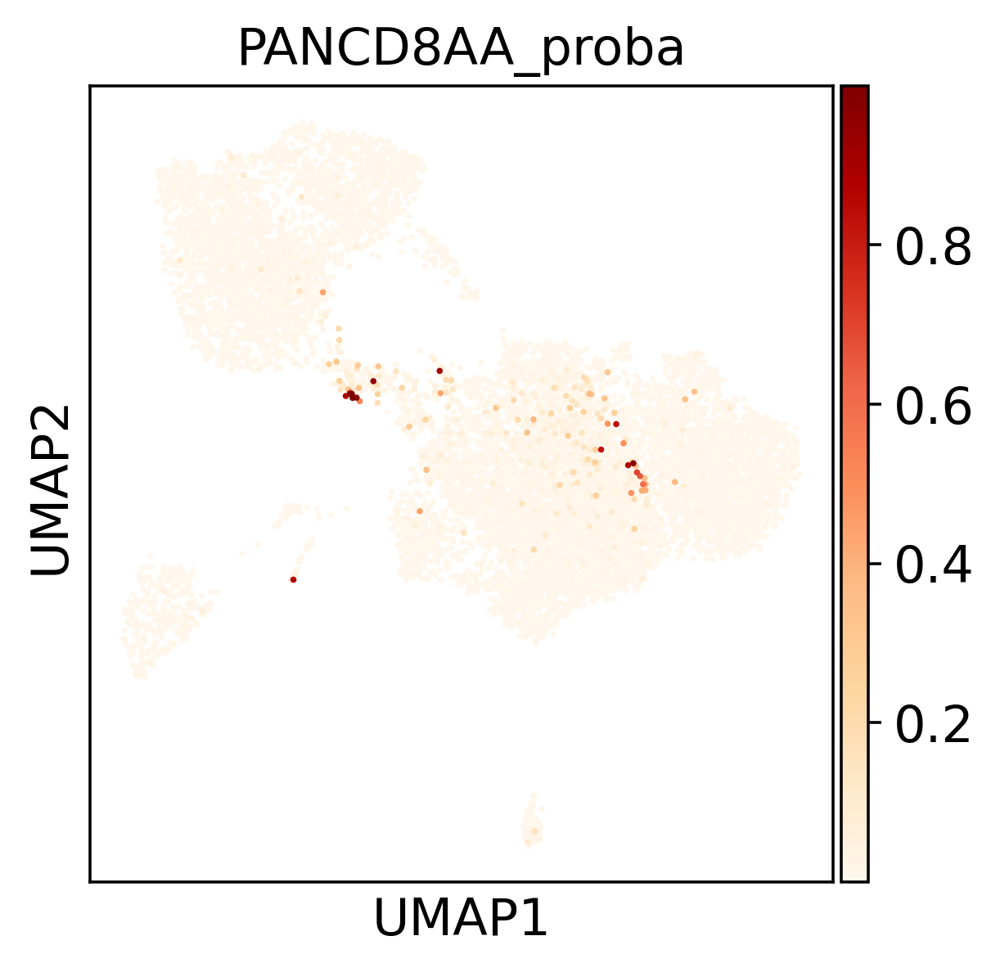

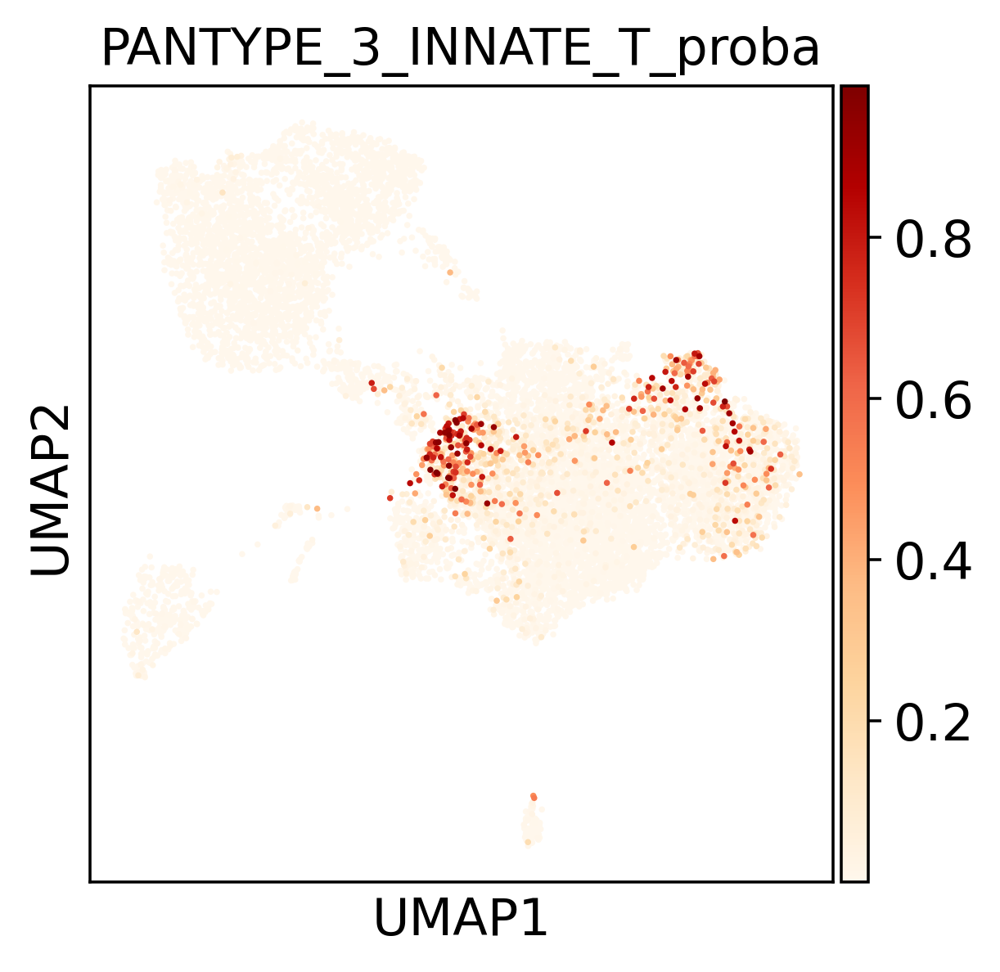

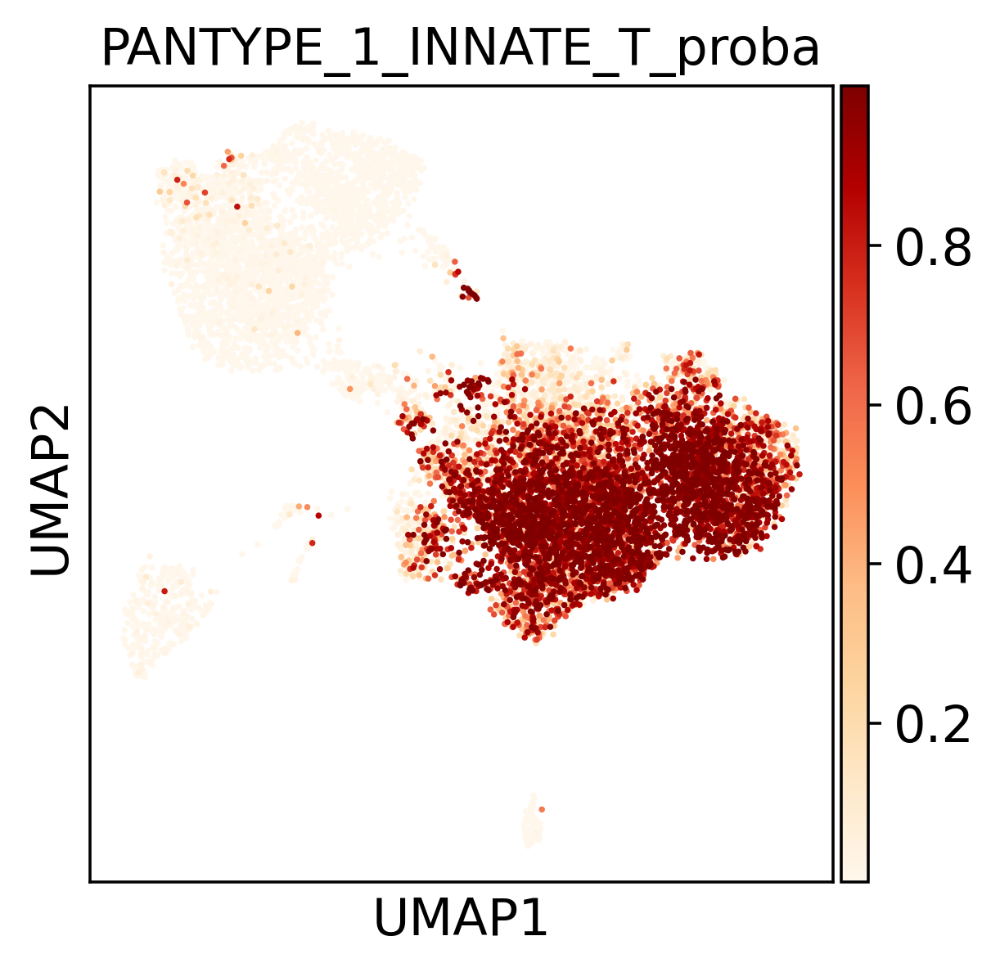

In [47]:
for x in ['CD8+T','CD4+T','CYCLING_T','ABT(ENTRY)','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T']:
    adata.obs['PAN'+x+'_proba'] = adata.obsm['proba'].loc[:,x]
    scjp.us(adata,'PAN'+x+'_proba')

# ATO TCR data

In [90]:
adata_tcr = sc.read('/home/jovyan/thymic_organoid_new/write/merged_TCR_analysed.h5ad')

In [91]:
adata_tcr.obs_names = [name.split('-')[1]+'-1_'+name.split('-')[0] for name in adata_tcr.obs_names]

In [92]:
obs_tcr = adata_tcr.obs.iloc[:,-51:]
for col in obs_tcr: 
    adata.obs[col]=obs_tcr[col]

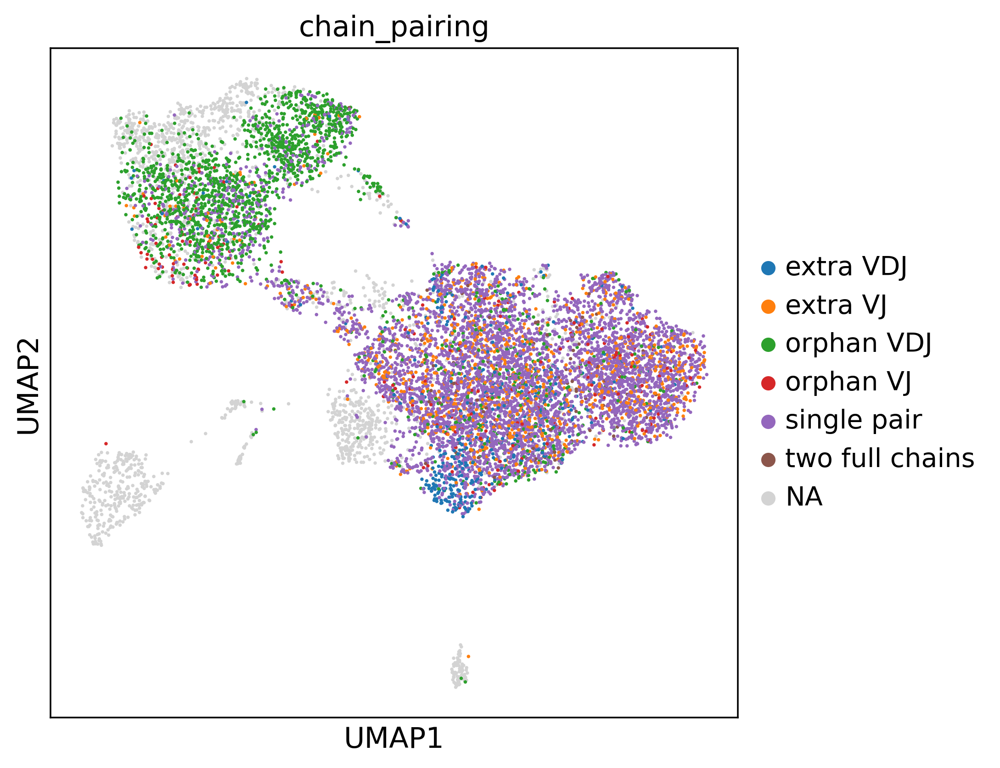

In [93]:
sc.pl.umap(adata, color=['chain_pairing'])

In [94]:
# load TCR list by location
TCR_list_by_loc = []
TCR_list_by_loc_dict = {}
for chain in ['TRAV','TRAJ','TRBV','TRBD','TRBJ']:
    path = '/home/jovyan/gene_list/'+chain+'_list_by_location.csv'
    TCR_list_by_loc_dict[chain] = list(pd.read_csv(path, header=None)[0])
    TCR_list_by_loc = TCR_list_by_loc + TCR_list_by_loc_dict[chain]

In [101]:
# check all genes from adata are inside
TRAV_list = list(adata.obs['IR_VJ_1_v_gene'].cat.categories[:-1])
TRAJ_list = list(adata.obs['IR_VJ_1_j_gene'].cat.categories[:-1])
TRBV_list = list(adata.obs['IR_VDJ_1_v_gene'].cat.categories[:-1])
TRBD_list = list(adata.obs['IR_VDJ_1_d_gene'].cat.categories[1:])
TRBJ_list = list(adata.obs['IR_VDJ_1_j_gene'].cat.categories[:-1])
TCR_list = TRAV_list+TRAJ_list+TRBV_list+TRBD_list+TRBJ_list

In [102]:
sum(~pd.Series(TCR_list).isin(TCR_list_by_loc))

0

### heatmap plotting

In [103]:
ct_select =['DN/DP','ABT(ENTRY)','SP_T']
TCR_chain = pd.DataFrame(columns = TCR_list_by_loc_dict['TRAV'],  index = ct_select)

In [105]:
for i in range(TCR_chain.shape[0]):
    cell = TCR_chain.index[i]
    counter = Counter(adata.obs.loc[adata.obs['anno_lvl_1']==cell,'IR_VJ_1_v_gene'])
    for chain_type in TCR_chain.columns:
        TCR_chain.loc[cell,chain_type] = counter[chain_type]
        
    TCR_chain.loc[cell,:] = TCR_chain.loc[cell,:] / np.sum(TCR_chain.loc[cell,:]) * 100

In [106]:
TCR_chain.columns = [a.replace('TR','') for a in TCR_chain.columns]

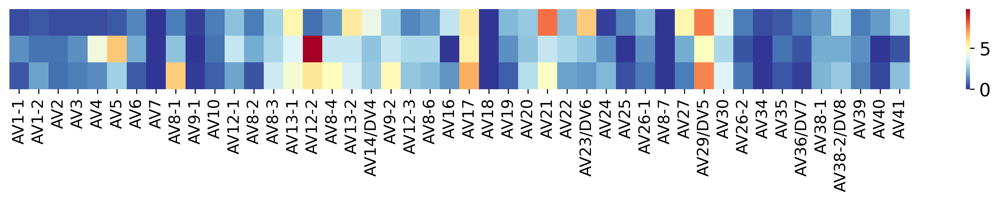

In [107]:
fig, ax = plt.subplots(figsize=(TCR_chain.shape[1]/3,TCR_chain.shape[0]*0.375))
#sb.set_theme()
uniform_data = TCR_chain
uniform_data=uniform_data.astype('float')
ax = sb.heatmap(uniform_data,cmap='RdYlBu_r')
_, xlabels = plt.xticks()
_, ylabels = plt.yticks()
ax.set_xticklabels(xlabels, size=12,rotation=90)
ax.set_yticklabels(ylabels, size=12,rotation=0)

ax.axes.get_yaxis().set_visible(False) # remove y axis tick and label
#plt.savefig(fig_path+'TCR_TRBJ.pdf',bbox_inches='tight');

In [125]:
adata.obs['anno_lvl_2_final_clean']=adata.obs['anno_lvl_1']
adata.obs['Sample']=['ATO_' + age for age in adata.obs['ATO_wk']]

In [341]:
adata_sp = adata[np.array(adata.obs['anno_lvl_1'].isin(['DN/DP','SP_T'])) & np.array(adata.obs['Sample'].isin(['ATO_wk5','ATO_wk7']))]

In [342]:
ato_obs = adata_sp.obs

In [177]:
ato_obs.columns=list(ato_obs.columns[:45])+['ab_'+name for name in ato_obs.columns[45:-2]]+list(ato_obs.columns[-2:])

### add these points to in vivo TCR PCA 

In [108]:
panfetal = sc.read('write/NKT_final_TCR.h5ad')

In [109]:
meta_ab = pd.read_csv('metadata/TCR_metadata_updated_20052021.csv',index_col=0)
meta_ab = meta_ab[meta_ab['type']=='VDJT']

In [110]:
# only take samples that had TCR sequencing done, and exclude CD137, MAIT sort
panfetal = panfetal[panfetal.obs['file'].isin(meta_ab['GEX_id'])].copy()
panfetal = panfetal[~(panfetal.obs['Sort_id'].isin(['CD137','MAIT']))]

In [251]:
bdata = panfetal[panfetal.obs['anno_lvl_2_final_clean'].isin(['DP(P)_T','DP(Q)_T','CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])]

In [252]:
bdata = bdata[bdata.obs['ab_chain_pairing'].isin(['single pair','extra VJ','extra VDJ','two full chains'])]

In [343]:
# merge in vivo and in vitro
data_merge = pd.concat([bdata.obs,ato_obs])

In [344]:
data_merge['smp_celltype'] = data_merge['Sample'].astype('string') +'_'+ data_merge['anno_lvl_2_final_clean'].astype('string')

In [345]:
df1 = pd.DataFrame({'smp_celltype': Counter(data_merge['smp_celltype']).keys(),
                  'cellcount': Counter(data_merge['smp_celltype']).values()})

In [346]:
new_list = df1.loc[df1['cellcount']>20,'smp_celltype'] # smp_celltype of at least 20 cells 

In [348]:
TCR_list = TRAV_list+TRAJ_list+TRBV_list+TRBJ_list

In [349]:
TCR = pd.DataFrame(columns = TCR_list, index = new_list)

In [350]:
for i in range(TCR.shape[0]):
    cell = TCR.index[i]
    counter1 = Counter(data_merge.loc[data_merge['smp_celltype']==cell,'ab_IR_VJ_1_v_gene'])
    for TRAV in TRAV_list:
        TCR.loc[cell,TRAV] = counter1[TRAV]
    
    counter2 = Counter(data_merge.loc[data_merge['smp_celltype']==cell,'ab_IR_VJ_1_j_gene'])
    for TRAJ in TRAJ_list:
        TCR.loc[cell,TRAJ] = counter2[TRAJ]
    
    counter3 = Counter(data_merge.loc[data_merge['smp_celltype']==cell,'ab_IR_VDJ_1_v_gene'])
    for TRBV in TRBV_list:
        TCR.loc[cell,TRBV] = counter3[TRBV]
        
    #counter4 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VDJ_1_v_gene'])
    #for TRBD in TRBD_list:
        #TCR.loc[cell,TRBD] = counter3[TRBD]
        
    counter5 = Counter(data_merge.loc[data_merge['smp_celltype']==cell,'ab_IR_VDJ_1_j_gene'])
    for TRBJ in TRBJ_list:
        TCR.loc[cell,TRBJ] = counter5[TRBJ]
        
    #counter6 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'IR_VDJ_1_c_gene'])
    #for TRBC in TRBC_list:
        #TCR.loc[cell,TRBC] = counter6[TRBC]
        
    # normalise  
    TCR.loc[cell,TCR.columns.isin(TRAV_list)] = TCR.loc[cell,TCR.columns.isin(TRAV_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRAV_list)]) * 100 
    TCR.loc[cell,TCR.columns.isin(TRAJ_list)] = TCR.loc[cell,TCR.columns.isin(TRAJ_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRAJ_list)]) * 100
    TCR.loc[cell,TCR.columns.isin(TRBV_list)] = TCR.loc[cell,TCR.columns.isin(TRBV_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBV_list)]) * 100
    #TCR.loc[cell,TCR.columns.isin(TRBD_list)] = TCR.loc[cell,TCR.columns.isin(TRBD_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBD_list)]) * 100 
    TCR.loc[cell,TCR.columns.isin(TRBJ_list)] = TCR.loc[cell,TCR.columns.isin(TRBJ_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBJ_list)]) * 100
    #TCR.loc[cell,TCR.columns.isin(TRBC_list)] = TCR.loc[cell,TCR.columns.isin(TRBC_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBC_list)]) * 100

In [351]:
df2 = pd.DataFrame(index = TCR.index, columns=['cell_type'])
df2['cell_type'] = list(TCR.index)

In [352]:
TCR_adata = sc.AnnData(X =np.array(TCR), obs = df2, var = list(TCR.columns))

In [353]:
sc.pp.pca(TCR_adata, n_comps = 30, use_highly_variable = False, svd_solver = 'arpack', random_state = 1712)
#sc.pp.neighbors(TCR_adata)
#sc.tl.umap(TCR_adata, random_state = 1712)

In [354]:
#TCR_adata.obs['cell_type']=TCR_adata.obs['cell_type'].astype('category')
TCR_adata.obs['cell_count']=lookup(TCR_adata.obs['cell_type'], df1,'smp_celltype','cellcount')
#TCR_adata.obs['donor'] = lookup(TCR_adata.obs_names, data_merge, 'smp_celltype','donor')
TCR_adata.obs['cell_type'] = lookup(TCR_adata.obs['cell_type'], data_merge,'smp_celltype','anno_lvl_2_final_clean')

In [355]:
PCA = TCR_adata.obsm['X_pca'][:,range(2)]

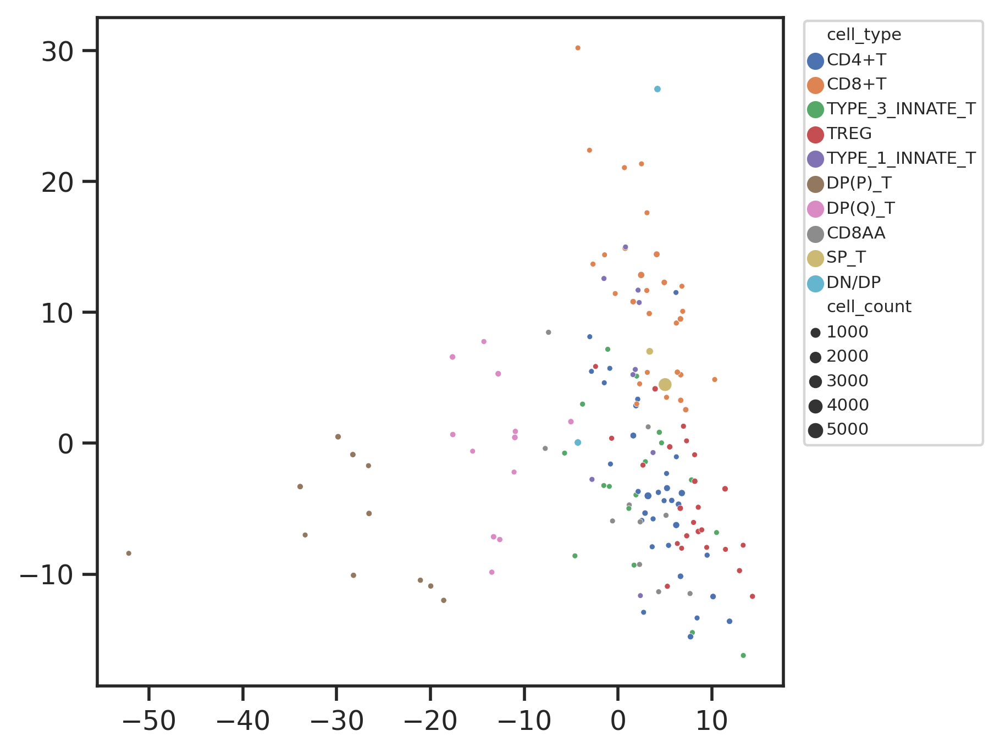

In [356]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(5,5))
sb.scatterplot(x=-PCA[:,0],y=PCA[:,1], hue=TCR_adata.obs['cell_type'],size = TCR_adata.obs['cell_count'],sizes=(5,30))
ax.legend(bbox_to_anchor=(1.03, 0.995), loc=2, borderaxespad=0.,fontsize='xx-small')
plt.savefig('figures/ATO_TCR.pdf',bbox_inches='tight');

In [357]:
ct_list = ['DP(P)_T','DP(Q)_T','TYPE_1_INNATE_T','CD8AA','TYPE_3_INNATE_T','CD4+T','TREG', 'CD8+T','DN/DP','SP_T']
df = pd.DataFrame({'PC1':-PCA[:,0],
                   'PC2':PCA[:,1],
                   'ct':TCR_adata.obs['cell_type'],
                   'cell_n': TCR_adata.obs['cell_count']
})
df['ct']=df['ct'].astype('category')
df['ct']=df['ct'].cat.reorder_categories(ct_list)

In [358]:
import sklearn 
pca = sklearn.decomposition.PCA(n_components =2)

def ct_centroid_dist(TCR):
    pc = pca.fit_transform(TCR)
    ct_centroid = pd.DataFrame(index=ct_list,
                               columns = ['PC1','PC2'])
    for ct in ct_list:
        tf = TCR_adata.obs['cell_type']==ct
        pc_ct = pc[tf,:]
        weights = np.ones(np.sum(tf))#np.array(TCR_adata.obs.loc[tf,'cell_count'])
        ct_centroid.loc[ct, :] = np.sum(pc_ct.T * weights, axis = 1) / np.sum(weights)
    ct_dist = pd.DataFrame(sp.spatial.distance.cdist(ct_centroid, ct_centroid), index = ct_list, columns = ct_list)
    return ct_dist, ct_centroid

In [359]:
ct_dist,ct_centroid=ct_centroid_dist(TCR)

In [360]:
ct_centroid.iloc[:,0]

DP(P)_T              28.9479
DP(Q)_T              12.9355
TYPE_1_INNATE_T      -1.1559
CD8AA               -1.03675
TYPE_3_INNATE_T     -2.38898
CD4+T               -4.19233
TREG                -7.45031
CD8+T               -3.25063
DN/DP              0.0435532
SP_T                -4.18885
Name: PC1, dtype: object

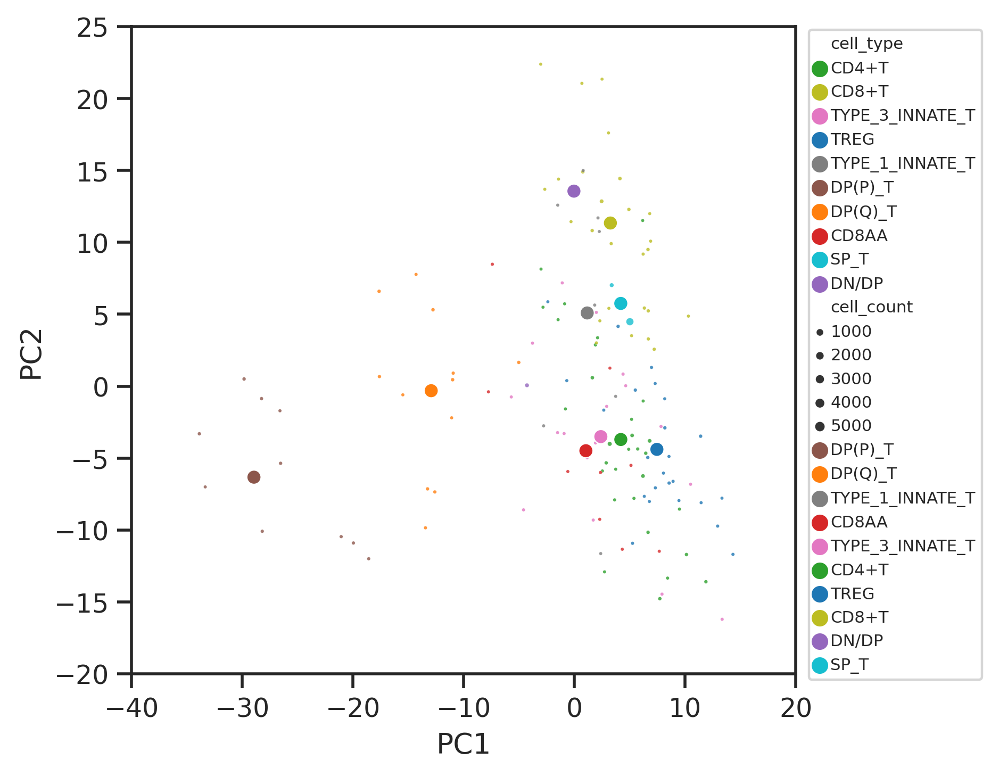

In [361]:
sb.set_theme(style='ticks')
color_order = np.array([5, 1, 7, 3, 6, 2, 0, 8,4,9])
ct_color_map = dict(zip(ct_list, np.array(sb.color_palette('tab10'))[color_order]))

fig, ax = plt.subplots(figsize=(5,5))
#plt.rcParams["figure.figsize"] = (5,5)
#sb.kdeplot(data=df, x="PC1", y="PC2", hue="ct", fill=True,weights='cell_n',alpha=0.25,levels=[0.2,1],bw=0.5)
sb.scatterplot(x=-PCA[:,0],y=PCA[:,1], hue=TCR_adata.obs['cell_type'],
               palette=ct_color_map,size = TCR_adata.obs['cell_count'],sizes=(2,10),alpha=0.8)
sb.scatterplot(x=-ct_centroid.iloc[:,0],y=ct_centroid.iloc[:,1], hue=ct_centroid.index,
               palette=ct_color_map)

ax.set_ylim(-20,25)
ax.set_xlim(-40,20)
ax.legend(bbox_to_anchor=(1.02, 0.995), loc=2, borderaxespad=0.,fontsize='xx-small')
plt.savefig('figures/ATO_TCR_PCA.pdf',bbox_inches='tight');

### similarity score after merging

In [25]:
merged= sc.read('/nfs/team205/ed6/data/Fetal_immune/ATO_query.mapped2LYMPHOID.withReference.h5ad')

Only considering the two last: ['.withReference', '.h5ad'].
Only considering the two last: ['.withReference', '.h5ad'].


In [14]:
annot = pd.read_csv('annot/ATO_scVI_anno.csv',sep=',', index_col=None)

In [15]:
adata.obs['anno_lvl_1']= np.nan
for i in range(annot.shape[0]):
    leiden = annot.iloc[i,0].astype('str')
    annot_lvl1 = annot.iloc[i,1]
    adata.obs.loc[adata.obs['leiden']==leiden,'anno_lvl_1'] = annot_lvl1

In [16]:
adata.obs['anno_lvl_1'] =adata.obs['anno_lvl_1'].astype('category')
adata.obs['anno_lvl_1'] =adata.obs['anno_lvl_1'].cat.reorder_categories(['DN/DP', 'ABT(ENTRY)', 'SP_T',
                                                                         'NK','ILC3', 'ERY', 'MAST CELL', 'HIGH_MITO'])